# Table of Contents
* [I. Import libraries and dataset](#part1)
  * [Import libraries](#section_1_1)
  * [Input the datasets](#section_1_2)
* [II. Explore data](#part2)
* [III. Data Preprocessing](#part3)
    * [Feature Engineering](#section_3_1)
    * [Explore each feature by is_fraud in the train set](#section_3_2)
        * [trans_time](#sub_section_3_2_1)
        * [Transaction Amount](#sub_section_3_2_2)
        * [Category](#sub_section_3_2_3)
        * [cc_num length](#sub_section_3_2_4)
        * [Gender](#sub_section_3_2_5)
        * [City population](#sub_section_3_2_6)
        * [Age](#sub_section_3_2_7)
        * [Distance](#sub_section_3_2_8)
        * [Jobs](#sub_section_3_2_9)
    * [Imputation](#section_3_3)
        * [Reduce number of unique values of 'job' and 'category' features](#sub_section_3_3_1)
        * [Encode 'job' and 'category' features](#sub_section_3_3_2)
        * [Normalizing](#sub_section_3_3_3)
        * [Split the processed data into train and test set](#sub_section_3_3_4)
    * [IV. Model selection, training, evaluation and optimizing](#part4)
        * [Baseline](#section_4_1)
        * [Optimizing](#section_4_2)
            * [Adding class_weight parameter to models](#sub_section_4_2_1)
            * [Random under-sampling train data](#sub_section_4_2_2)
            * [SMOTE (Synthetic Minority Oversampling Technique)](#sub_section_4_2_3)
    * [V. Conclusion](#part5)

# I. Import libraries and dataset <a class='anchor' id='part1'></a>

## Import libraries <a class='anchor' id='section_1_1'></a>

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import time
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import KFold, cross_val_score, train_test_split
from sklearn.utils import resample
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.metrics import precision_score, recall_score, f1_score, classification_report, balanced_accuracy_score
%matplotlib inline

In [2]:
! pip install ydata-profiling
! pip install imbalanced-learn
! pip install xgboost

## Input the datasets <a class='anchor' id='section_1_2'></a>

In [3]:
train = pd.read_csv(r"D:\UNIGAP DATA COACHING 1 ON 1\ML\FINAL PROJECT\fraudTrain.csv")
test = pd.read_csv(r"D:\UNIGAP DATA COACHING 1 ON 1\ML\FINAL PROJECT\fraudTest.csv")

#Create tag 'train', 'test' on the train and test sets for later concatenating. 
train['dataset'] = 'train'
test['dataset'] = 'test'

# II. Explore data <a class='anchor' id='part2'></a>

In [4]:
#Perform basic EDA for train set using pandas_profiling.
from ydata_profiling import ProfileReport

train_prof = ProfileReport(train)
train_prof

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [5]:
#Perform basic EDA for train set using pandas_profiling.
test_prof = ProfileReport(test)
test_prof

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## From above profiling of train and test data, we can see that:

- There are no missing values and no duplicated observations.
- There are outliers in cc_num, amt, lat, long, city_pop, merch_lat, merch_long
- is_fraud is highly imbalanced.
- None of the above features is correlated with is_fraud

=> Create new features and change features

=> Further EDA on each feature

=> Using approaches to tackle imbalanced data.


# III. Data Preprocessing <a class='anchor' id='part3'></a>

## Feature Engineering <a class='anchor' id='section_3_1'></a>

In [6]:
#Concatenate train and test data to perform preprocessing on both train and test set at once.
df = pd.concat([train, test], ignore_index=True)

In [7]:
#Create trans_time (hour) from trans_date_trans_time
df['trans_time'] = pd.to_datetime(df['trans_date_trans_time']).dt.hour

df['trans_time'] = df['trans_time'].apply(lambda x: 1 if x in [22, 23, 0, 1, 2, 3] else 0)

#Create age of person at the time each transaction occurred.
df['age'] = pd.to_datetime(df['trans_date_trans_time']).dt.year - pd.to_datetime(df['dob']).dt.year

#Create distance between the payer and the merchant from lat, long, merch_lat, merch_long
def haversine(lat1, long1, lat2, long2):
    lat1_rad = np.radians(lat1)
    long1_rad = np.radians(long1)
    lat2_rad = np.radians(lat2)
    long2_rad = np.radians(long2)
    
    d_lat = lat2_rad - lat1_rad
    d_long = long2_rad - long1_rad
    a = np.sin(d_lat/2)**2 + np.cos(lat1_rad)*np.cos(lat2_rad)*np.sin(d_long/2)**2
    c = 2 * np.arctan2(np.sqrt(a), np.sqrt(1 - a))
    earth_radius = 6371.0
    distance_km = earth_radius * c
    
    return distance_km

df['distance'] = haversine(df['lat'], df['long'], df['merch_lat'], df['merch_long'])

In [8]:
df.head()

,Unnamed: 0,trans_date_trans_time,cc_num,merchant,category,amt,first,last,gender,street,...,dob,trans_num,unix_time,merch_lat,merch_long,is_fraud,dataset,trans_time,age,distance
0,0,2019-01-01 00:00:18,2703186189652095,"fraud_Rippin, Kub and Mann",misc_net,4.97,Jennifer,Banks,F,561 Perry Cove,...,1988-03-09,0b242abb623afc578575680df30655b9,1325376018,36.011293,-82.048315,0,train,1,31,78.597568
1,1,2019-01-01 00:00:44,630423337322,"fraud_Heller, Gutmann and Zieme",grocery_pos,107.23,Stephanie,Gill,F,43039 Riley Greens Suite 393,...,1978-06-21,1f76529f8574734946361c461b024d99,1325376044,49.159047,-118.186462,0,train,1,41,30.212176
2,2,2019-01-01 00:00:51,38859492057661,fraud_Lind-Buckridge,entertainment,220.11,Edward,Sanchez,M,594 White Dale Suite 530,...,1962-01-19,a1a22d70485983eac12b5b88dad1cf95,1325376051,43.150704,-112.154481,0,train,1,57,108.206083
3,3,2019-01-01 00:01:16,3534093764340240,"fraud_Kutch, Hermiston and Farrell",gas_transport,45.00,Jeremy,White,M,9443 Cynthia Court Apt. 038,...,1967-01-12,6b849c168bdad6f867558c3793159a81,1325376076,47.034331,-112.561071,0,train,1,52,95.673231
4,4,2019-01-01 00:03:06,375534208663984,fraud_Keeling-Crist,misc_pos,41.96,Tyler,Garcia,M,408 Bradley Rest,...,1986-03-28,a41d7549acf90789359a9aa5346dcb46,1325376186,38.674999,-78.632459,0,train,1,33,77.556744


## Explore each feature by is_fraud in the train set <a class='anchor' id='section_3_2'></a>

In [9]:
#Create train set from df
train_df = df[df['dataset'] == 'train'].copy()

In [10]:
sns.set(style='whitegrid')

### trans_time <a class='anchor' id='sub_section_3_2_1'></a>

Suspect that fraud transactions are more likely to happen in night time, so we will EDA the 'trans_time' feature with 'is_fraud' on train set.

In [11]:
fraud_by_trans_time = pd.pivot_table(train_df, index=['trans_time'], columns=['is_fraud'], aggfunc='size', fill_value=0)
fraud_by_trans_time = fraud_by_trans_time.reset_index()
fraud_by_trans_time['%fraud'] = fraud_by_trans_time[1] / (fraud_by_trans_time[0] + fraud_by_trans_time[1]) * 100.0
fraud_by_trans_time.index.name = None
fraud_by_trans_time

is_fraud,trans_time,0,1,%fraud
0,0,990649,1144,0.115347
1,1,298520,6362,2.086709


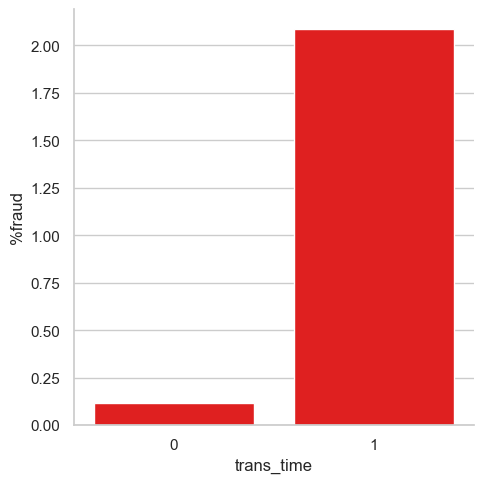

In [12]:
sns.catplot(fraud_by_trans_time, x='trans_time', y='%fraud', kind='bar', color='Red')

From the above chart, we can see that percentage of transactions being fraudulent is higher during night time (22pm - 3am)
<p>=> We will put trans_time into model.</p>

### Transaction Amount <a class='anchor' id='sub_section_3_2_2'></a>

Hypothesis: Higher value transactions are more likely to be fraudulent.

In [13]:
no_fraud = train_df[train_df['is_fraud'] == 0][['amt']]
fraud = train_df[train_df['is_fraud'] == 1][['amt']]

no_fraud_amt = no_fraud.describe()
fraud_amt = fraud.describe()
print(no_fraud_amt.merge(fraud_amt, left_index=True, right_index=True, suffixes=['_no_fraud', '_fraud']))

no_fraud_iqr = no_fraud.quantile(0.75) - no_fraud.quantile(0.25)
no_fraud_upper_line = no_fraud.quantile(0.75) + 1.5 * no_fraud_iqr

print('Percentage of fraudulent transactions that have amount in outlier area of the non-fraud: {:.2f}%'\
      .format(fraud[fraud['amt'] > no_fraud_upper_line['amt']].shape[0] / fraud.shape[0] * 100.0))

       amt_no_fraud    amt_fraud
count  1.289169e+06  7506.000000
mean   6.766711e+01   531.320092
std    1.540080e+02   390.560070
min    1.000000e+00     1.060000
25%    9.610000e+00   245.662500
50%    4.728000e+01   396.505000
75%    8.254000e+01   900.875000
max    2.894890e+04  1376.040000
Percentage of fraudulent transactions that have amount in outlier area of the non-fraud: 76.01%


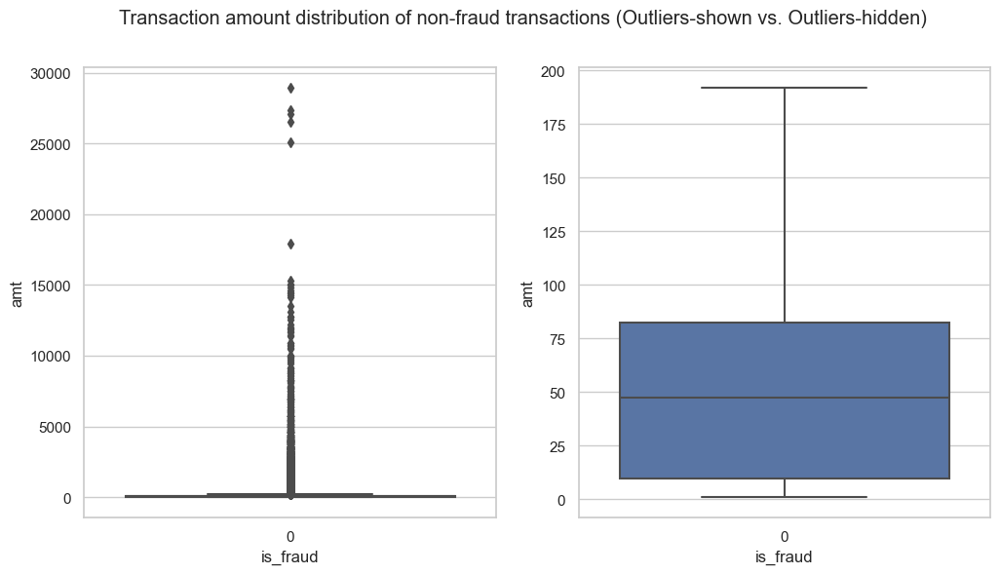

In [14]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(12, 6))
s = sns.boxplot(train_df[train_df['is_fraud'] == 0], x='is_fraud', y='amt', showfliers=True, ax=ax1)
s = sns.boxplot(train_df[train_df['is_fraud'] == 0], x='is_fraud', y='amt', showfliers=False, ax = ax2)
plt.suptitle('Transaction amount distribution of non-fraud transactions (Outliers-shown vs. Outliers-hidden)')
plt.show()

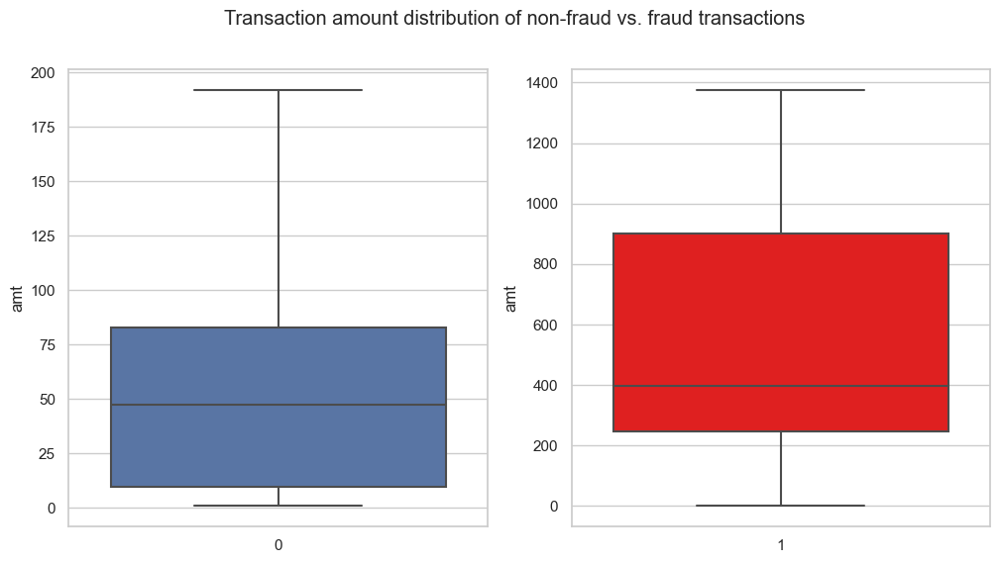

In [15]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(12, 6))
s = sns.boxplot(train_df[train_df['is_fraud'] == 0], x='is_fraud', y='amt', showfliers=False, ax=ax1)
s = sns.boxplot(train_df[train_df['is_fraud'] == 1], x='is_fraud', y='amt', showfliers=False, color='Red', ax = ax2)
plt.suptitle('Transaction amount distribution of non-fraud vs. fraud transactions')
ax1.set_xlabel(None)
ax2.set_xlabel(None)
plt.show()

Without outliers, we could see that the fraud group have higher mean and median than the normal group. 76% of all frauds have transaction amount in the outlier area of non-fraud transaction amount.
<p>=> The higher amount, the higher fraud probability => 'amt' is somewhat correlated with 'is_fraud', hence it will be put into model.</p>

### Category <a class='anchor' id='sub_section_3_2_3'></a>

Some categories might have significantly higher fraud percentage than others.

In [16]:
fraud_by_cat = pd.pivot_table(train_df, index='category', columns=['is_fraud'], aggfunc='size', fill_value=0)
fraud_by_cat.reset_index(inplace=True)
fraud_by_cat['%fraud'] = fraud_by_cat[1] / (fraud_by_cat[1] + fraud_by_cat[0]) * 100
fraud_by_cat

is_fraud,category,0,1,%fraud
0,entertainment,93781,233,0.247835
1,food_dining,91310,151,0.165098
2,gas_transport,131041,618,0.469394
3,grocery_net,45318,134,0.294817
4,grocery_pos,121895,1743,1.409761
5,health_fitness,85746,133,0.154869
6,home,122917,198,0.160825
7,kids_pets,112796,239,0.211439
8,misc_net,62372,915,1.445795
9,misc_pos,79405,250,0.313853


<Axes: ylabel='%fraud'>

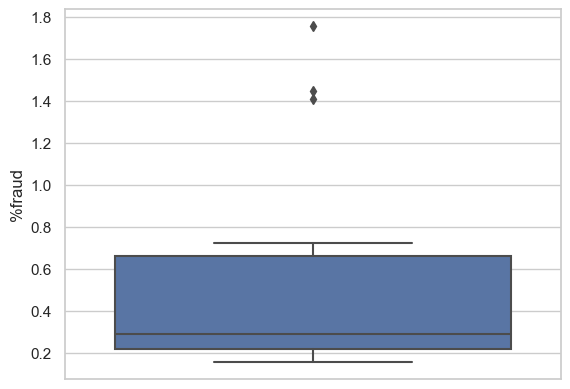

In [17]:
sns.boxplot(fraud_by_cat, y='%fraud')

In terms of category, 'grocery_pos', 'misc_net', 'shopping_net' are the categories that have significant higher fraud percentage than the rest.

=> Put 'category' in the model

### cc_num length <a class='anchor' id='sub_section_3_2_4'></a>

Unusual length of cc_num could indicate a fraud. Let's see if it is the case.

In [18]:
draft = train_df[['cc_num', 'is_fraud']].copy()
draft['length'] = draft['cc_num'].apply(lambda x: len(str(x)))
fraud_by_cc_num_len = pd.pivot_table(draft, index='length', columns='is_fraud', aggfunc='size', fill_value=0)
fraud_by_cc_num_len.reset_index(inplace=True)
fraud_by_cc_num_len['%fraud'] = fraud_by_cc_num_len[1] / (fraud_by_cc_num_len[0] + fraud_by_cc_num_len[1]) * 100.0
fraud_by_cc_num_len

is_fraud,length,0,1,%fraud
0,11,6056,55,0.900016
1,12,90903,565,0.617702
2,13,88625,581,0.651301
3,14,125382,603,0.478628
4,15,214849,1119,0.518132
5,16,645232,3916,0.603252
6,19,118122,667,0.561500


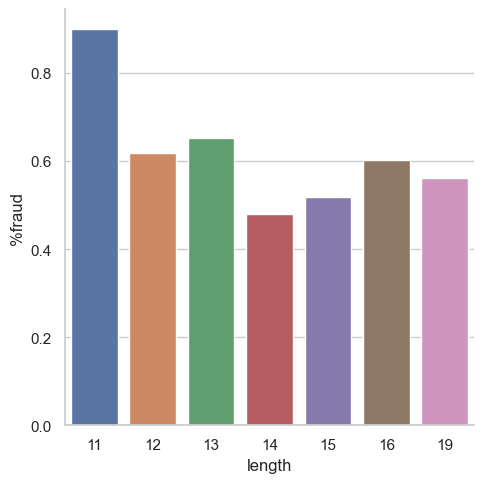

In [19]:
sns.catplot(fraud_by_cc_num_len, x='length', y='%fraud', kind='bar')

Not much difference in %fraud among different length of cc_num

=> Exclude cc_num length from the model.

### Gender <a class='anchor' id='sub_section_3_2_5'></a>

Maybe a gender is having significantly higher fraud percentage than that of the other.

In [20]:
fraud_by_gender = pd.pivot_table(train_df, index='gender', columns='is_fraud', aggfunc='size')
fraud_by_gender.reset_index(inplace=True)
fraud_by_gender['%fraud'] = fraud_by_gender[1] / (fraud_by_gender[1] + fraud_by_gender[0]) * 100.0
fraud_by_gender

is_fraud,gender,0,1,%fraud
0,F,706128,3735,0.526158
1,M,583041,3771,0.642625


Not much difference in fraud percentage between male and female

=> Exclude gender from model

### City population <a class='anchor' id='sub_section_3_2_6'></a>

Maybe higher population cities have higher fraud percentage.

<Axes: xlabel='is_fraud', ylabel='city_pop'>

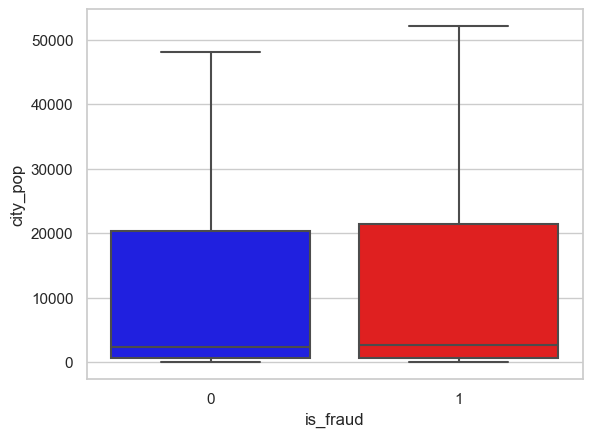

In [21]:
sns.boxplot(train_df, x='is_fraud', y='city_pop', showfliers=False, palette=['Blue', 'Red'])

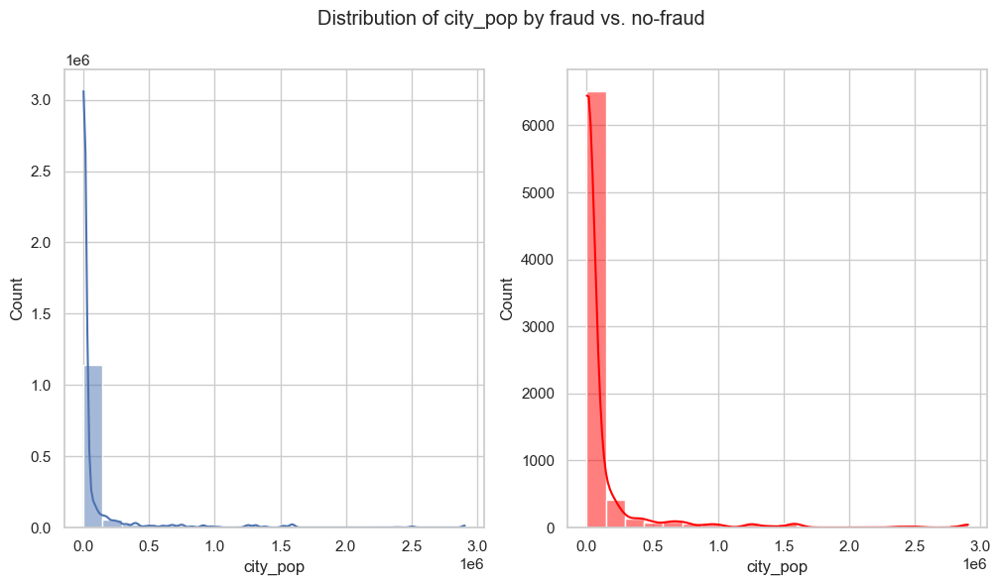

In [22]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(12, 6))
s = sns.histplot(train_df[train_df['is_fraud'] == 0], x='city_pop', bins=20, kde=True, ax = ax1)
s = sns.histplot(train_df[train_df['is_fraud'] == 1], x='city_pop', bins=20, kde=True, color='Red', ax = ax2)
plt.suptitle('Distribution of city_pop by fraud vs. no-fraud')
plt.xlabel('city_pop')
plt.show()

We can see that the fraud rate for lower city_pop tends to be a little higher than that of higher city_pop.

=> Include city_pop in the model

### Age <a class='anchor' id='sub_section_3_2_7'></a>

It could be that people in certain age groups tend to make more fraud transactions.

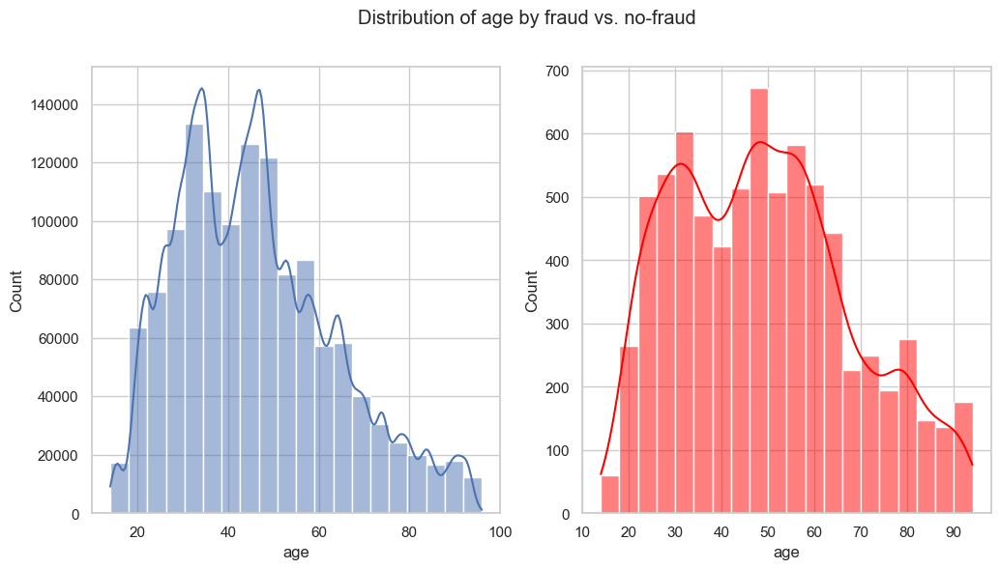

In [23]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(12, 6))
s = sns.histplot(train_df[train_df['is_fraud'] == 0], x='age', bins=20, kde=True, ax = ax1)
s = sns.histplot(train_df[train_df['is_fraud'] == 1], x='age', bins=20, kde=True, color='Red', ax = ax2)
plt.suptitle('Distribution of age by fraud vs. no-fraud')
plt.xlabel('age')
plt.show()

The age distribution of fraud and no-fraud groups are having the same tendency. They peak at around 30 - 50 year-old group and gradually decrease among 60 or more year-old.

=> age not affect the fraud probability => Exclude age from model

### Distance <a class='anchor' id='sub_section_3_2_8'></a>

Fraudulent transaction could occur with unusual far distance. Let's check that out.

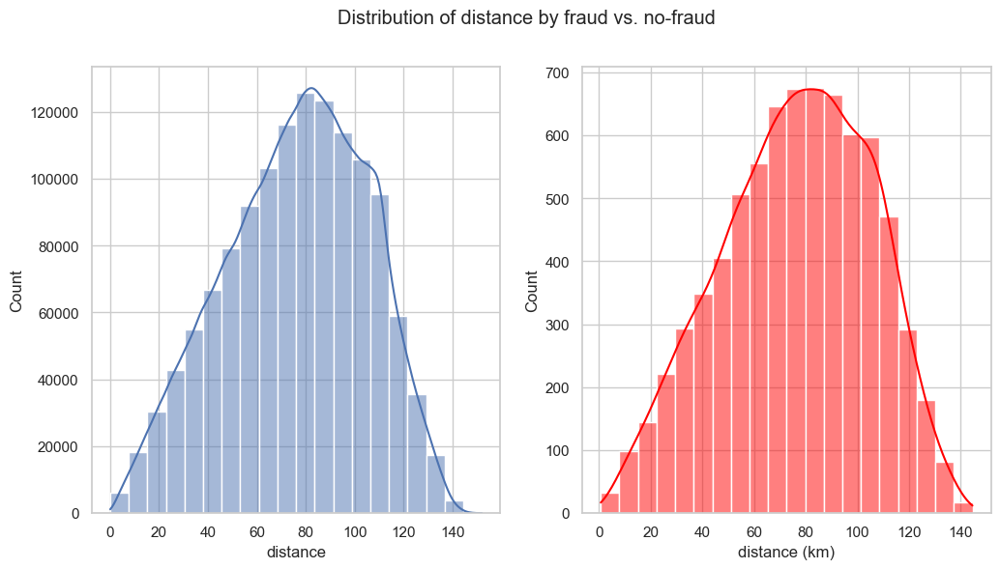

In [24]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(12, 6))
s = sns.histplot(train_df[train_df['is_fraud'] == 0], x='distance', bins=20, kde=True, ax = ax1)
s = sns.histplot(train_df[train_df['is_fraud'] == 1], x='distance', bins=20, kde=True, color='Red', ax = ax2)
plt.suptitle('Distribution of distance by fraud vs. no-fraud')
plt.xlabel('distance (km)')
plt.show()

Again, little difference in distance distribution between fraud and no-fraud groups

=> Distance doesn't affect fraud => Exclude distance from model

### Jobs <a class='anchor' id='sub_section_3_2_9'></a>

People with certain jobs might make more fraud.

In [25]:
fraud_by_job = pd.pivot_table(train_df, index='job', columns='is_fraud', aggfunc='size', fill_value=0)
fraud_by_job.reset_index(inplace=True)
fraud_by_job['%fraud'] = fraud_by_job[1] / (fraud_by_job[0] + fraud_by_job[1]) * 100.0
fraud_by_job.sort_values(1, ascending=False)

is_fraud,job,0,1,%fraud
286,Materials engineer,8208,62,0.749698
477,Trading standards officer,4585,56,1.206637
308,Naval architect,8631,53,0.610318
187,Exhibition designer,9148,51,0.554408
439,"Surveyor, land/geomatics",8630,50,0.576037
...,...,...,...,...
230,"Horticulturist, commercial",2034,0,0.000000
410,"Scientist, clinical (histocompatibility and im...",1054,0,0.000000
104,"Conservator, furniture",536,0,0.000000
116,Dance movement psychotherapist,2017,0,0.000000


In [26]:
#Among jobs, there are titles which only have fraud transactions.
fraud_by_job[fraud_by_job['%fraud'] == 100].sort_values(1, ascending=False)

is_fraud,job,0,1,%fraud
117,Dancer,0,19,100.0
20,Air traffic controller,0,17,100.0
61,Careers adviser,0,15,100.0
405,Sales promotion account executive,0,14,100.0
332,Personnel officer,0,12,100.0
172,"Engineer, site",0,12,100.0
267,Legal secretary,0,12,100.0
1,"Accountant, chartered",0,11,100.0
426,Solicitor,0,11,100.0
227,Homeopath,0,11,100.0


In [27]:
fraud_by_job['%fraud'].describe()

count    494.000000
mean       4.550176
std       19.119307
min        0.000000
25%        0.352487
50%        0.635353
75%        0.982078
max      100.000000
Name: %fraud, dtype: float64

<Axes: ylabel='%fraud'>

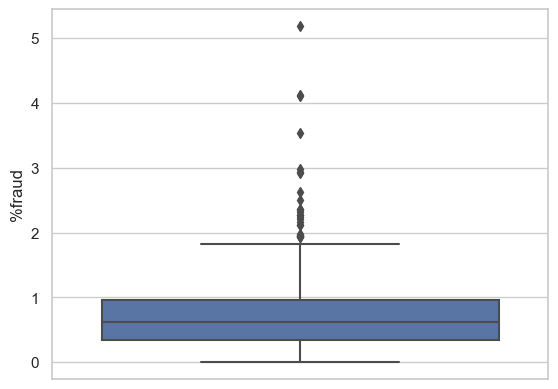

In [28]:
sns.boxplot(fraud_by_job[fraud_by_job['%fraud'] < 100], y='%fraud')

If we exclude all of the jobs that has 100% fraud, we could see that there are some titles that has fraud percentage much higher than others.

=> We could insert 'job' into model but impute this feature a little bit.

### After EDA all features by is_fraud on train set, the meaningful features are:
- trans_time
- amt
- category
- job
- city_pop

As the 'category' and 'job' are categorical features, we will impute them to input into model.

## Imputation <a class='anchor' id='section_3_3'></a>

First, we will filter only necessary features and target from df (train and test set combined).

In [29]:
df = df[['Unnamed: 0', 'trans_time', 'amt', 'category', 'job', 'city_pop', 'is_fraud', 'dataset']]

#'Unnamed: 0' is the old index column of both train set and test set.
#We keep 'dataset' column to split train and test set later.

In [30]:
df.head()

,Unnamed: 0,trans_time,amt,category,job,city_pop,is_fraud,dataset
0,0,1,4.97,misc_net,"Psychologist, counselling",3495,0,train
1,1,1,107.23,grocery_pos,Special educational needs teacher,149,0,train
2,2,1,220.11,entertainment,Nature conservation officer,4154,0,train
3,3,1,45.00,gas_transport,Patent attorney,1939,0,train
4,4,1,41.96,misc_pos,Dance movement psychotherapist,99,0,train


### Reduce number of unique values of 'job' and 'category' features <a class='anchor' id='sub_section_3_3_1'></a>

#### category

As of the above analysis, 'grocery_pos', 'misc_net', 'shopping_net' are 3 categories that have significant higher fraud percentage than the rest. So we will group other unique values of 'category' into '.other' class.

In [31]:
df['category'] = df['category'].apply(lambda x: x if x in ['grocery_pos', 'misc_net', 'shopping_net'] else '.other')

In [32]:
df.head()

,Unnamed: 0,trans_time,amt,category,job,city_pop,is_fraud,dataset
0,0,1,4.97,misc_net,"Psychologist, counselling",3495,0,train
1,1,1,107.23,grocery_pos,Special educational needs teacher,149,0,train
2,2,1,220.11,.other,Nature conservation officer,4154,0,train
3,3,1,45.00,.other,Patent attorney,1939,0,train
4,4,1,41.96,.other,Dance movement psychotherapist,99,0,train


#### job

There are too many unique values in this feature, so we will group all job titles that has values of 95-percentile or lower. We also put all the job titles that have fraud only into the 'other' group, because the number of observations of fraud-only titles are too small to be considered significant.

In [33]:
perc_fraud = fraud_by_job[fraud_by_job['%fraud'] < 100]['%fraud'].tolist()
y = np.nanpercentile(perc_fraud, 95)

#Retrieve series of jobs that have fraud percentage of 95th-percentile or lower or 100%.
other_job = fraud_by_job[(fraud_by_job['%fraud'] <= y) | (fraud_by_job['%fraud'] == 100)]['job'].tolist()

#Change value of all jobs in the other_job to 'other'
df['job'] = df['job'].apply(lambda x: '.other' if x in other_job else x)

In [34]:
df.head()

,Unnamed: 0,trans_time,amt,category,job,city_pop,is_fraud,dataset
0,0,1,4.97,misc_net,.other,3495,0,train
1,1,1,107.23,grocery_pos,.other,149,0,train
2,2,1,220.11,.other,.other,4154,0,train
3,3,1,45.00,.other,.other,1939,0,train
4,4,1,41.96,.other,.other,99,0,train


### Encode 'job' and 'category' features <a class='anchor' id='sub_section_3_3_2'></a>

In [35]:
#Encode 'category' feature
cat_dummies = pd.get_dummies(df['category'], prefix='cat', drop_first=True)
df = df.drop('category', axis=1).join(cat_dummies)

In [36]:
#Encode 'job' feature
job_dummies = pd.get_dummies(df['job'], prefix='job', drop_first=True)
df = df.drop('job', axis=1).join(job_dummies)

In [37]:
df.head()

,Unnamed: 0,trans_time,amt,city_pop,is_fraud,dataset,cat_grocery_pos,cat_misc_net,cat_shopping_net,job_Artist,...,job_Medical technical officer,job_Minerals surveyor,job_Operational investment banker,"job_Pharmacist, hospital",job_Purchasing manager,job_Software engineer,"job_Solicitor, Scotland",job_TEFL teacher,"job_Teacher, adult education",job_Writer
0,0,1,4.97,3495,0,train,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
1,1,1,107.23,149,0,train,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,2,1,220.11,4154,0,train,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,3,1,45.00,1939,0,train,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,4,1,41.96,99,0,train,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


### Normalizing <a class='anchor' id='sub_section_3_3_3'></a>

In [38]:
#Scale features
columns_list = ['trans_time', 'amt', 'city_pop']
scaler = MinMaxScaler()
model = scaler.fit(df[columns_list])
scaled_data = model.transform(df[columns_list])

#Put scaled data to dataframe
scaled_data = pd.DataFrame(scaled_data, columns=columns_list)

#Replace the old columns in the df with new ones
df.drop(columns=columns_list, inplace=True)
df = df.join(scaled_data)

### Split the processed data into train and test set <a class='anchor' id='sub_section_3_3_4'></a>

In [39]:
df_train = df[df['dataset'] == 'train'].copy().drop(columns=['dataset']).set_index('Unnamed: 0')
df_train.head()

,is_fraud,cat_grocery_pos,cat_misc_net,cat_shopping_net,job_Artist,job_Charity officer,job_Chief of Staff,job_Civil Service administrator,job_Clinical cytogeneticist,job_Community development worker,...,"job_Pharmacist, hospital",job_Purchasing manager,job_Software engineer,"job_Solicitor, Scotland",job_TEFL teacher,"job_Teacher, adult education",job_Writer,trans_time,amt,city_pop
Unnamed: 0,,,,,,,,,,,,,,,,,,,,,
0,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1.0,0.000137,0.001194
1,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1.0,0.003670,0.000043
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1.0,0.007569,0.001421
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1.0,0.001520,0.000659
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1.0,0.001415,0.000026


In [40]:
df_test = df[df['dataset'] == 'test'].copy().drop(columns=['dataset']).set_index('Unnamed: 0')
df_test.head()

,is_fraud,cat_grocery_pos,cat_misc_net,cat_shopping_net,job_Artist,job_Charity officer,job_Chief of Staff,job_Civil Service administrator,job_Clinical cytogeneticist,job_Community development worker,...,"job_Pharmacist, hospital",job_Purchasing manager,job_Software engineer,"job_Solicitor, Scotland",job_TEFL teacher,"job_Teacher, adult education",job_Writer,trans_time,amt,city_pop
Unnamed: 0,,,,,,,,,,,,,,,,,,,,,
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0.0,0.000064,0.114727
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0.0,0.000996,0.000096
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0.0,0.001391,0.011860
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0.0,0.002040,0.018834
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0.0,0.000076,0.000379


# IV. Model selection, training, evaluation and optimizing <a class='anchor' id='part4'></a>

In this part, we will fit various classification models into train data. Then we will calculate performance of each model to choose the best one. We will also use some techniques to deal with imbalanced data to get better results.

## Baseline <a class='anchor' id='section_4_1'></a>

We will try 4 different classification models below without any changes in model hyperparameters or usage of imbalanced data imputing techniques:
- Logistic Regression
- Decision Tree
- Random Forest
- Gradient Boosting
- XGBoost

Then we will calculate the important metrics (recall, f1-score) to see which model has the best performance. We choose recall and f1-score as the main metrics because in fraud detection problem, we have to focus on spotting all fraudulent cases but we have to make sure that the number of non-fraud transactions flagged as fraudulent is relatively low, which means false negative cases must be lessen and there shouldn't be too many false positive cases.

### Logistic Regression & Decision Tree

In [41]:
X = df_train.drop(columns=['is_fraud'])
y = df_train['is_fraud']

X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

X_test = df_test.drop(columns=['is_fraud'])
y_test = df_test['is_fraud']

models = {'Logistic Regression': LogisticRegression(random_state=42),
          'Decision Tree': DecisionTreeClassifier(random_state=42)}

for name, model in models.items():
    model.fit(X_train, y_train)
    
    #Run model on validating data
    y_pred = model.predict(X_val)
    print(name + ':\n')
    print('Validation performance:\n', classification_report(y_val, y_pred), '\nBalanced accuracy score: ' + str(balanced_accuracy_score(y_val, y_pred)))
    
    #Run model on test data
    y_pred = model.predict(X_test)
    print('Test performance:\n', classification_report(y_test, y_pred), '\nBalanced accuracy score: ' + str(balanced_accuracy_score(y_test, y_pred)))

Logistic Regression:

Validation performance:
               precision    recall  f1-score   support

           0       0.99      1.00      1.00    257834
           1       0.09      0.00      0.01      1501

    accuracy                           0.99    259335
   macro avg       0.54      0.50      0.50    259335
weighted avg       0.99      0.99      0.99    259335
 
Balanced accuracy score: 0.5012568149800942
Test performance:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00    553574
           1       0.04      0.00      0.00      2145

    accuracy                           1.00    555719
   macro avg       0.52      0.50      0.50    555719
weighted avg       0.99      1.00      0.99    555719
 
Balanced accuracy score: 0.5008529174306469
Decision Tree:

Validation performance:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00    257834
           1       0.59      0.58      0

### Random Forest & Gradient Boosting

In [42]:
models = {'Random Forest': RandomForestClassifier(random_state=42),
          'Gradient Boosting': GradientBoostingClassifier(random_state=42)}

for name, model in models.items():
    model.fit(X_train, y_train)
    
    #Run model on validating data
    y_pred = model.predict(X_val)
    print(name + ':\n')
    print('Validation performance:\n', classification_report(y_val, y_pred), '\nBalanced accuracy score: ' + str(balanced_accuracy_score(y_val, y_pred)))
    
    #Run model on test data
    y_pred = model.predict(X_test)
    print('Test performance:\n', classification_report(y_test, y_pred), '\nBalanced accuracy score: ' + str(balanced_accuracy_score(y_test, y_pred)))

Random Forest:

Validation performance:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00    257834
           1       0.82      0.60      0.69      1501

    accuracy                           1.00    259335
   macro avg       0.91      0.80      0.84    259335
weighted avg       1.00      1.00      1.00    259335
 
Balanced accuracy score: 0.7974155584779234
Test performance:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00    553574
           1       0.73      0.57      0.64      2145

    accuracy                           1.00    555719
   macro avg       0.86      0.78      0.82    555719
weighted avg       1.00      1.00      1.00    555719
 
Balanced accuracy score: 0.7825781364804152
Gradient Boosting:

Validation performance:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00    257834
           1       0.85      0.60      0.7

### XGBoost

In [43]:
import xgboost as xgb

model = xgb.XGBClassifier(random_state=42, n_estimators=200)
model.fit(X_train, y_train)

#Run model on validation data
y_pred = model.predict(X_val)
print('XGBoost:\n')
print('Validation performance:\n', classification_report(y_val, y_pred), '\nBalanced accuracy score: ' + str(balanced_accuracy_score(y_val, y_pred)))
    
#Run model on test data
y_pred = model.predict(X_test)
print('Test performance:\n', classification_report(y_test, y_pred), '\nBalanced accuracy score: ' + str(balanced_accuracy_score(y_test, y_pred)))

XGBoost:

Validation performance:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00    257834
           1       0.87      0.61      0.72      1501

    accuracy                           1.00    259335
   macro avg       0.93      0.81      0.86    259335
weighted avg       1.00      1.00      1.00    259335
 
Balanced accuracy score: 0.8061869874525913
Test performance:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00    553574
           1       0.79      0.56      0.66      2145

    accuracy                           1.00    555719
   macro avg       0.89      0.78      0.83    555719
weighted avg       1.00      1.00      1.00    555719
 
Balanced accuracy score: 0.7796661554811324


From above result, we could see that Logistic Regression is way under-performed in this case, where as the tree and ensemble models are applicable. Gradient Boosting is the best model with recall of 0.59 and f1-score of 0.65.

We will apply techniques on dealing with imbalanced data to see if the models become better.

## Optimizing <a class='anchor' id='section_4_2'></a>

### Adding class_weight parameter to models <a class='anchor' id='sub_section_4_2_1'></a>

In classification models, class_weight is a parameter used to define weight for each class of the target. It will penalize the major class and buff the minor class, so it's a good technique to use in this problem.

In [44]:
#Remove Logistic Regression
models = {'Decision Tree': DecisionTreeClassifier(random_state=42, class_weight='balanced'),
          'Random Forest': RandomForestClassifier(random_state=42, class_weight='balanced')}

for name, model in models.items():
    model.fit(X_train, y_train)
    
    #Run model on validating data
    y_pred = model.predict(X_val)
    print(name + ':\n')
    print('Validation performance:\n', classification_report(y_val, y_pred), '\nBalanced accuracy score: ' + str(balanced_accuracy_score(y_val, y_pred)))
    
    #Run model on test data
    y_pred = model.predict(X_test)
    print('Test performance:\n', classification_report(y_test, y_pred), '\nBalanced accuracy score: ' + str(balanced_accuracy_score(y_test, y_pred)))

Decision Tree:

Validation performance:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00    257834
           1       0.60      0.57      0.58      1501

    accuracy                           1.00    259335
   macro avg       0.80      0.78      0.79    259335
weighted avg       1.00      1.00      1.00    259335
 
Balanced accuracy score: 0.7823781368773612
Test performance:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00    553574
           1       0.49      0.55      0.52      2145

    accuracy                           1.00    555719
   macro avg       0.74      0.77      0.76    555719
weighted avg       1.00      1.00      1.00    555719
 
Balanced accuracy score: 0.7746258390791914
Random Forest:

Validation performance:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00    257834
           1       0.83      0.60      0.69   

Compare to not using the class_weight, Decision Tree and Random Forest performed worse, precision of Gradient Boosting decreased. Hence, we need other technique.

### Random under-sampling train data <a class='anchor' id='sub_section_4_2_2'></a>

One of the common technique used to increase efficiency of model on imbalanced data is random under-sampling, which is to randomly decrease the size of the major class data to balance with size of minor class data.

We will perform under-sampling on the train data for the model to fit, then run on validating set and test set and calculate the performance.

This time we will use Gradient Boosting only as this model proves to be better than Decision Tree, Random Forest and XGBoost in this problem. We also use different no-fraud and fraud ratios to see which one gives the best score.

In [45]:
#Seperate no-fraud and fraud from train data
df_train_no_fraud = df_train[df_train['is_fraud'] == 0]
df_train_fraud = df_train[df_train['is_fraud'] == 1]

ratio_range = np.arange(1, 152, 10).tolist()
precision = []
recall = []
f1 = []

for ratio in ratio_range:

    #Under-sampling the non-fraud in the train set
    df_train_nofraud_rus = df_train_no_fraud.sample(ratio*len(df_train_fraud), random_state=0)

    #Create balanced train set
    df_random_under = pd.concat([df_train_nofraud_rus, df_train_fraud])

    X = df_random_under.drop(['is_fraud'], axis=1)
    y = df_random_under['is_fraud']

    X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)
    
    model = GradientBoostingClassifier()
    model.fit(X_train, y_train)

    #Run model on validating data
    y_pred = model.predict(X_val)

    #Run model on test data
    y_pred = model.predict(X_test)
    precision.append(precision_score(y_test, y_pred))
    recall.append(recall_score(y_test, y_pred))
    f1.append(f1_score(y_test, y_pred))

    ratio  precision    recall  f1_score
0       1   0.073356  0.913753  0.135809
1      11   0.340809  0.722611  0.463170
2      21   0.375245  0.713753  0.491888
3      31   0.602151  0.678788  0.638177
4      41   0.652912  0.663869  0.658345
5      51   0.674832  0.655012  0.664774
6      61   0.698452  0.652214  0.674542
7      71   0.713254  0.644755  0.677277
8      81   0.713764  0.638228  0.673886
9      91   0.732577  0.632168  0.678679
10    101   0.753557  0.617249  0.678626
11    111   0.760490  0.608392  0.675991
12    121   0.780371  0.607925  0.683438
13    131   0.755620  0.611189  0.675773
14    141   0.709124  0.539860  0.613023
15    151   0.790431  0.546853  0.646459


<Axes: xlabel='ratio', ylabel='value'>

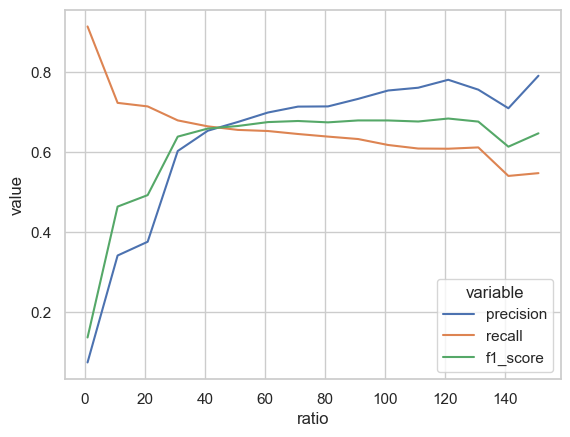

In [46]:
result = pd.DataFrame({'ratio': ratio_range, 'precision': precision, 'recall': recall, 'f1_score': f1})
print(result)

sns.lineplot(data=pd.melt(result, ['ratio']), x='ratio', y='value', hue='variable')

We can see that as the no fraud - fraud ratio increases, recall score drops while precision score and f1_score increase. From above graph, the model has the best performance with ratio at around 31, precision of 0.626, recall of 0.673, f1_score of 0.649.

However, this is not as high as we expected. So let's try another technique.

### SMOTE (Synthetic Minority Oversampling Technique) <a class='anchor' id='sub_section_4_2_3'></a>

Another way to counter imbalance of dataset is to oversampling the minor class. In this case, I will use a widely used oversampling technique called SMOTE.

In [47]:
from imblearn.over_sampling import SMOTE

sm = SMOTE()

X = df_train.drop(columns=['is_fraud'])
y = df_train['is_fraud']

X_sm, y_sm = sm.fit_resample(X, y)

In [48]:
X_train, X_val, y_train, y_val = train_test_split(X_sm, y_sm, test_size=0.2, random_state=42)

model = GradientBoostingClassifier()
model.fit(X_train, y_train)

y_pred = model.predict(X_val)
print('Validation performance:\n', classification_report(y_val, y_pred))

y_pred = model.predict(X_test)
print('Test performance:\n', classification_report(y_test, y_pred))

Validation performance:
               precision    recall  f1-score   support

           0       0.93      0.95      0.94    257186
           1       0.95      0.93      0.94    258482

    accuracy                           0.94    515668
   macro avg       0.94      0.94      0.94    515668
weighted avg       0.94      0.94      0.94    515668

Test performance:
               precision    recall  f1-score   support

           0       1.00      0.95      0.98    553574
           1       0.07      0.92      0.13      2145

    accuracy                           0.95    555719
   macro avg       0.54      0.94      0.56    555719
weighted avg       1.00      0.95      0.97    555719



We can see that SMOTE has the same tendency as of random under-sampling technique. With no-fraud and fraud ratio of 1:1, the model has very high recall, low precision and f1-score.

# V. Conclusion <a class='anchor' id='part5'></a>

In fraud detection problem, with heavily imbalanced data, using Gradient Boosting model and random under-sampling technique is a good method to bring the best result. In this case, we yield a model with recall score of 0.652 and f1 score of 0.675 using random under-sampling with minority-majority ratio of 61:1.

Further investigating into features is required to get higher result.